In [1]:
import SimpleITK as sitk
import matplotlib.pyplot as plt
#%matplotlib notebook
from skimage.segmentation import mark_boundaries
from skimage.transform import downscale_local_mean, rotate
import numpy as np
import os
import tifffile
OUTPUT_DIR = "output"
from scipy import ndimage
import time

In [2]:
low_res_path = 'data/11_Substack (305-698)_B40_bag126_127.tif'

registered_path = 'data/registered_image11_3dCT_B40_bag126_127_1002mm.tif'

In [3]:
low_res = tifffile.imread(low_res_path)
print ('file is found!', low_res.shape)

registered = tifffile.imread(registered_path)
print ('file is found!', registered.shape)

file is found! (788, 1798, 1790)
file is found! (788, 1798, 1790)


In [4]:
def check_figs(original_image,registered,thresh = 60):

    mask = np.zeros_like(registered,dtype='uint8')
    mask[registered>=thresh] = 1
    mask[registered<thresh] = 0
    
    # Create a figure with subplots for displaying multiple images
    fig, axes = plt.subplots(nrows=5, ncols=5, figsize=(50, 80))

    # Flatten the axes array to iterate over subplots
    axes = axes.flatten()

    for i, ax in enumerate(axes[:]):
        i = i*25+20
        overlay = mark_boundaries(original_image[i], mask[i], color=(1, 0, 0))  # Overlay boundaries on the image
        ax.imshow(overlay)
        ax.axis('off')  # Turn off axis labels
        ax.set_title(f"Image {i+1}")

    fig.subplots_adjust(wspace=0.1, hspace=0.3)
    plt.tight_layout()  # Adjust layout
    plt.savefig('ckeck_registration_11.pdf')
    #plt.show()

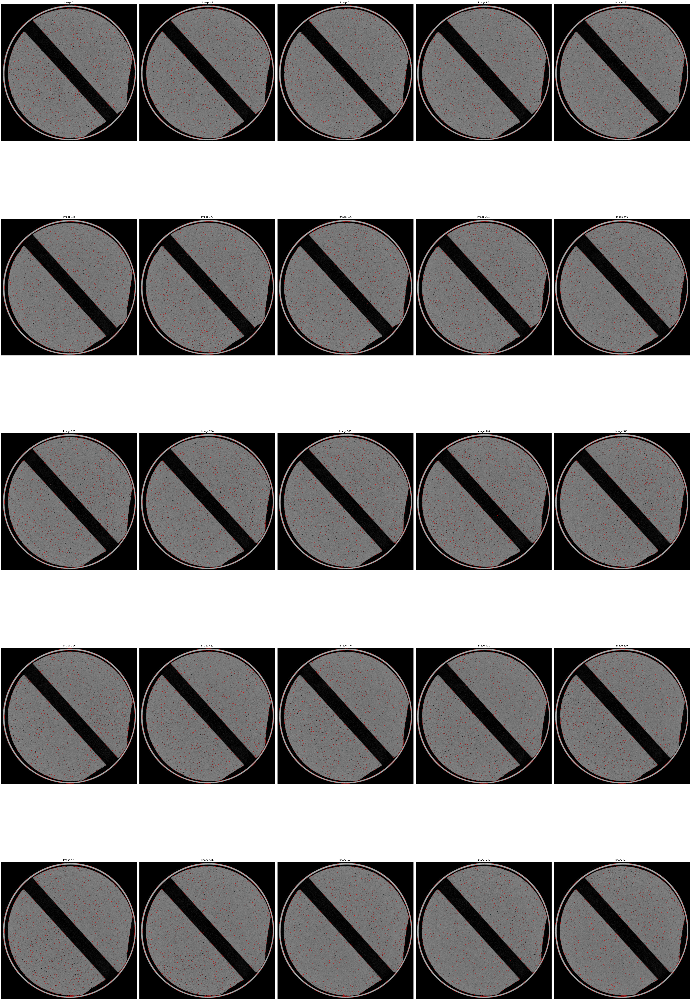

In [5]:
check_figs(low_res,registered)